In [1]:
# import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import plotly.express as px
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, silhouette_score
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [2]:
dataset = pd.read_csv("time_series_data_human_activities.csv")
dataset

,user,activity,timestamp,x-axis,y-axis,z-axis
0,1,Walking,4991922345000,0.69,10.80,-2.030000
1,1,Walking,4991972333000,6.85,7.44,-0.500000
2,1,Walking,4992022351000,0.93,5.63,-0.500000
3,1,Walking,4992072339000,-2.11,5.01,-0.690000
4,1,Walking,4992122358000,-4.59,4.29,-1.950000
...,...,...,...,...,...,...
1073618,36,Standing,15049012250000,-0.91,9.43,2.533385
1073619,36,Standing,15049062268000,-1.18,9.51,2.492524
1073620,36,Standing,15049112287000,-1.50,9.53,2.533385
1073621,36,Standing,15049162275000,-2.07,8.77,2.179256


In [3]:
# Define the reduction factor
reduction_factor = 10

# Calculate the target number of rows for each activity
activity_counts = dataset['activity'].value_counts()
target_rows = {}
for activity, count in activity_counts.items():
    target_rows[activity] = count // reduction_factor

# Create an empty DataFrame to store the selected rows
data = pd.DataFrame()

# Randomly select and append rows for each activity
for activity, target in target_rows.items():
    activity_rows = dataset[dataset['activity'] == activity]
    selected_rows = activity_rows.sample(target, random_state=42)  # You can change the random_state for reproducibility
    data = data.append(selected_rows)

# Reset the index of the selected data
data.reset_index(drop=True, inplace=True)

C:\Users\wwwta\AppData\Local\Temp\ipykernel_20164\2185901547.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data = data.append(selected_rows)
C:\Users\wwwta\AppData\Local\Temp\ipykernel_20164\2185901547.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data = data.append(selected_rows)
C:\Users\wwwta\AppData\Local\Temp\ipykernel_20164\2185901547.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data = data.append(selected_rows)
C:\Users\wwwta\AppData\Local\Temp\ipykernel_20164\2185901547.py:17: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  data = data.append(selected_rows)
C:\Users\wwwta\AppData\Local\Temp\ipykernel_20164\21

In [4]:
data

,user,activity,timestamp,x-axis,y-axis,z-axis
0,9,Walking,9587592328000,6.74,1.54,-2.560000
1,20,Walking,421172282000,-2.07,11.73,-5.597963
2,28,Walking,1704843761000,0.89,4.71,0.612916
3,28,Walking,1583762218000,0.89,10.61,1.607201
4,30,Walking,419352367000,17.20,-8.88,-2.110000
...,...,...,...,...,...,...
107355,20,Standing,59736262310000,-0.91,9.66,2.410000
107356,20,Standing,59584042339000,-1.18,9.51,3.260000
107357,16,Standing,58588242291000,0.89,9.96,0.340000
107358,6,Standing,58965292278000,-0.46,9.66,1.880000


In [5]:
#top 5 rows
data.head()

,user,activity,timestamp,x-axis,y-axis,z-axis
0,9,Walking,9587592328000,6.74,1.54,-2.560000
1,20,Walking,421172282000,-2.07,11.73,-5.597963
2,28,Walking,1704843761000,0.89,4.71,0.612916
3,28,Walking,1583762218000,0.89,10.61,1.607201
4,30,Walking,419352367000,17.20,-8.88,-2.110000


In [6]:
# last 5 rows
data.tail()

,user,activity,timestamp,x-axis,y-axis,z-axis
107355,20,Standing,59736262310000,-0.91,9.66,2.41
107356,20,Standing,59584042339000,-1.18,9.51,3.26
107357,16,Standing,58588242291000,0.89,9.96,0.34
107358,6,Standing,58965292278000,-0.46,9.66,1.88
107359,3,Standing,102657101508000,-1.14,9.38,-0.42


In [7]:
# Number of rows and columns
data.shape

(107360, 6)

In [8]:
data.describe()

,user,timestamp,x-axis,y-axis,z-axis
count,107360.000000,1.073600e+05,107360.000000,107360.000000,107360.000000
mean,18.758886,3.313635e+13,0.686742,7.325372,0.405034
std,10.291079,4.923915e+13,6.906685,6.736749,4.796077
min,1.000000,7.495231e+10,-19.610000,-19.610000,-19.610000
25%,10.000000,2.057537e+12,-2.960000,3.300000,-2.260978
50%,19.000000,9.860182e+12,0.380000,8.010000,-0.040000
75%,28.000000,4.956700e+13,4.520000,11.600000,2.750000
max,36.000000,2.093968e+14,19.950000,20.040000,19.610000


In [9]:
# check is there any duplicated values are there or not
data.duplicated()

0         False
1         False
2         False
3         False
4         False
          ...  
107355    False
107356    False
107357    False
107358    False
107359    False
Length: 107360, dtype: bool

In [10]:
data.isnull()

,user,activity,timestamp,x-axis,y-axis,z-axis
0,False,False,False,False,False,False
1,False,False,False,False,False,False
2,False,False,False,False,False,False
3,False,False,False,False,False,False
4,False,False,False,False,False,False
...,...,...,...,...,...,...
107355,False,False,False,False,False,False
107356,False,False,False,False,False,False
107357,False,False,False,False,False,False
107358,False,False,False,False,False,False


In [11]:
data.isnull().sum()

user         0
activity     0
timestamp    0
x-axis       0
y-axis       0
z-axis       0
dtype: int64

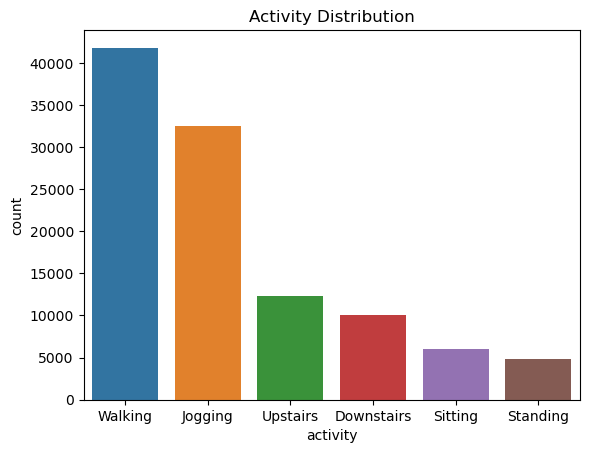

In [12]:
# Visualize activity distribution
sns.countplot(x='activity', data=data)
plt.title('Activity Distribution')
plt.show()

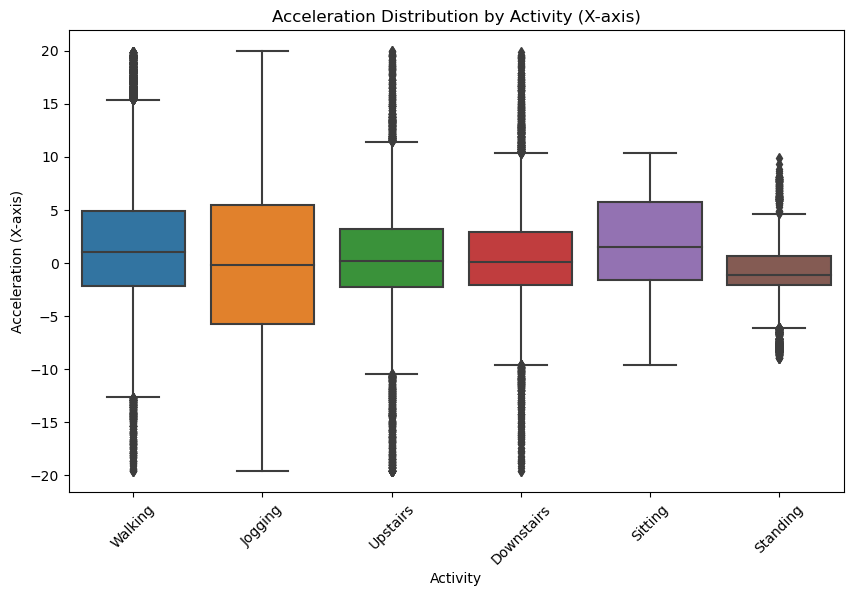

In [13]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=data, x='activity', y='x-axis')
plt.xlabel('Activity')
plt.ylabel('Acceleration (X-axis)')
plt.title('Acceleration Distribution by Activity (X-axis)')
plt.xticks(rotation=45)
plt.show()

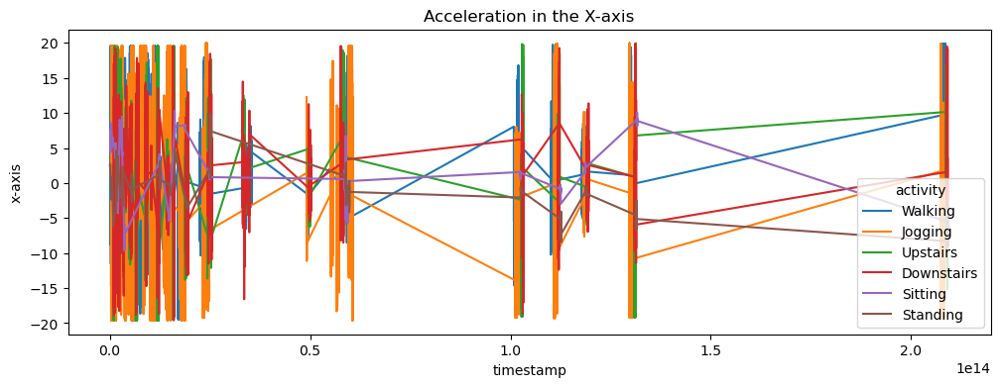

In [14]:
# Visualize acceleration in the x-axis
plt.figure(figsize=(12, 4))
sns.lineplot(data=data, x='timestamp', y='x-axis', hue='activity')
plt.title('Acceleration in the X-axis')
plt.show()

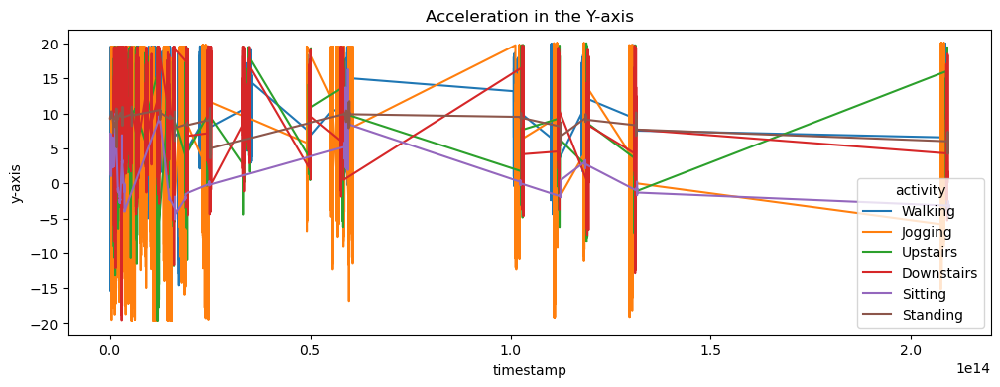

In [15]:
# Visualize acceleration in the y-axis
plt.figure(figsize=(12, 4))
sns.lineplot(data=data, x='timestamp', y='y-axis', hue='activity')
plt.title('Acceleration in the Y-axis')
plt.show()

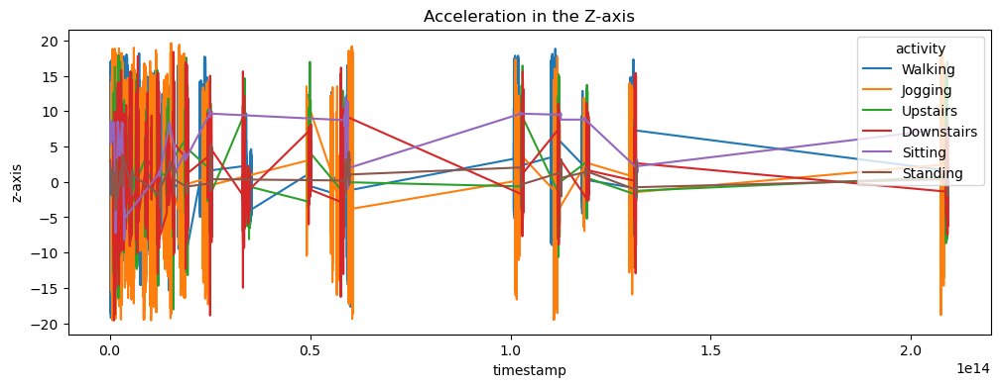

In [16]:
# Visualize acceleration in the z-axis
plt.figure(figsize=(12, 4))
sns.lineplot(data=data, x='timestamp', y='z-axis', hue='activity')
plt.title('Acceleration in the Z-axis')
plt.show()

In [17]:
# Select the relevant columns
features = data[['x-axis', 'y-axis', 'z-axis']]

# Standardize the data
scaler = StandardScaler()
scaled_features = scaler.fit_transform(features)

In [18]:
#K-Means Clustering
features = data[['x-axis', 'y-axis', 'z-axis']]
kmeans = KMeans(n_clusters=6, random_state=0) 
data['cluster'] = kmeans.fit_predict(features)

C:\Users\wwwta\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [19]:
# Determine the optimal number of clusters using the Elbow Method
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(scaled_features)
    wcss.append(kmeans.inertia_)

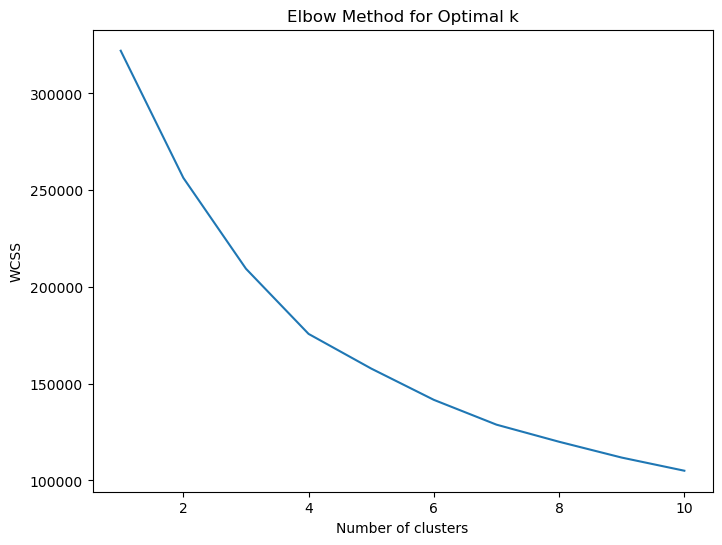

In [20]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), wcss)
plt.title('Elbow Method for Optimal k')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [21]:
# Based on the Elbow Method, choose the optimal number of clusters and perform K-Means clustering
k = 4  
kmeans = KMeans(n_clusters=k, init='k-means++', max_iter=300, n_init=10, random_state=0)
cluster_labels = kmeans.fit_predict(scaled_features)

In [22]:
# Add the cluster labels to the original dataset
data['cluster'] = cluster_labels

In [23]:
# Calculate Silhouette Score
silhouette_avg = silhouette_score(scaled_features, cluster_labels)
print(f'Silhouette Score: {silhouette_avg}')

Silhouette Score: 0.2344563941518827


In [24]:
# Create an interactive 3D scatter plot
fig = px.scatter_3d(data, x='x-axis', y='y-axis', z='z-axis', color='activity', symbol='activity', title='3D Scatter Plot')
fig.show()

In [25]:
# Create an interactive pie chart for activity distribution
activity_distribution = data['activity'].value_counts().reset_index()
activity_distribution.columns = ['Activity', 'Count']
fig = px.pie(activity_distribution, names='Activity', values='Count', title='Activity Distribution')
fig.show()

In [26]:
# Get cluster centers
cluster_centers = scaler.inverse_transform(kmeans.cluster_centers_)

In [27]:
# Create a 3D scatter plot with cluster centers
# Create a 3D scatter plot with cluster centers
fig = px.scatter_3d(data, x='x-axis', y='y-axis', z='z-axis', color=data['cluster'], title='3D Scatter Plot with Clusters')
fig.add_scatter3d(x=cluster_centers[:, 0], y=cluster_centers[:, 1], z=cluster_centers[:, 2], mode='markers', marker=dict(size=10, symbol='cross', color='red'))
fig.show()

In [28]:
# Convert 'cluster_labels' to strings
cluster_labels = cluster_labels.astype(str)

# Define 'true_labels' based on your dataset
true_labels = data['activity']

# Calculate the confusion matrix
confusion = confusion_matrix(true_labels, cluster_labels)

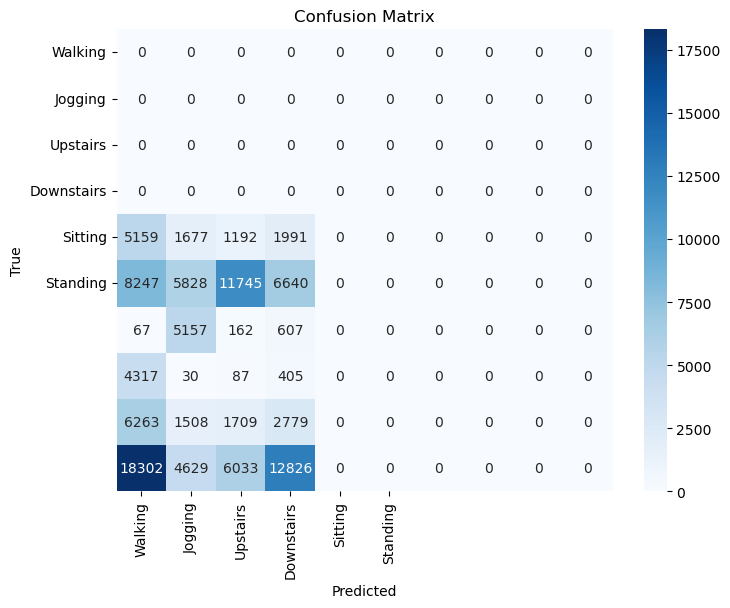

In [29]:
# Plot the confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=data['activity'].unique(), yticklabels=data['activity'].unique())
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [30]:
labeled_data = pd.read_csv("time_series_data_human_activities.csv")
# Split the data into features (X) and labels (y)
X = labeled_data[['x-axis', 'y-axis', 'z-axis']]
y = labeled_data['activity']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a Decision Tree classifier (you can choose other classifiers too)
classifier = DecisionTreeClassifier()

# Train the classifier on the training data
classifier.fit(X_train, y_train)

# Make predictions on the test data
y_pred = classifier.predict(X_test)

# Evaluate the accuracy of the classifier
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 0.5417208056816859


In [31]:
#K-Fold Cross-Validation
X = features
y = data['activity']
log_reg = LogisticRegression(max_iter=1000)

In [32]:
# Using 5-fold cross-validation
scores = cross_val_score(log_reg, X, y, cv=5)
mean_accuracy = np.mean(scores)

In [33]:
#Activity Recognition with Logistic Regression
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)
log_reg.fit(X_train, y_train)
y_pred = log_reg.predict(X_test)

In [34]:
#Evaluate the Logistic Regression Model
accuracy = accuracy_score(y_test, y_pred)
confusion = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

C:\Users\wwwta\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\wwwta\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\wwwta\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [35]:
#Clustering Metrics (Silhouette Score)
silhouette_avg = silhouette_score(features, data['cluster'])

In [36]:
# Print results
print(f"Mean Cross-Validation Accuracy: {mean_accuracy}")
print(f"Logistic Regression Accuracy: {accuracy}")
print(f"Confusion Matrix:\n{confusion}")
print(f"Classification Report:\n{classification_rep}")
print(f"Silhouette Score: {silhouette_avg}")

Mean Cross-Validation Accuracy: 0.4767883755588673
Logistic Regression Accuracy: 0.4755495529061103
Confusion Matrix:
[[   0  302   18    0    0 1696]
 [   0 2779  474    0    0 3311]
 [   0  331  576    0    0  232]
 [   0   89    0    0    0  900]
 [   0  482   37    0    0 1888]
 [   0 1396  105    0    0 6856]]
Classification Report:
              precision    recall  f1-score   support

  Downstairs       0.00      0.00      0.00      2016
     Jogging       0.52      0.42      0.47      6564
     Sitting       0.48      0.51      0.49      1139
    Standing       0.00      0.00      0.00       989
    Upstairs       0.00      0.00      0.00      2407
     Walking       0.46      0.82      0.59      8357

    accuracy                           0.48     21472
   macro avg       0.24      0.29      0.26     21472
weighted avg       0.36      0.48      0.40     21472

Silhouette Score: 0.23468032666519237


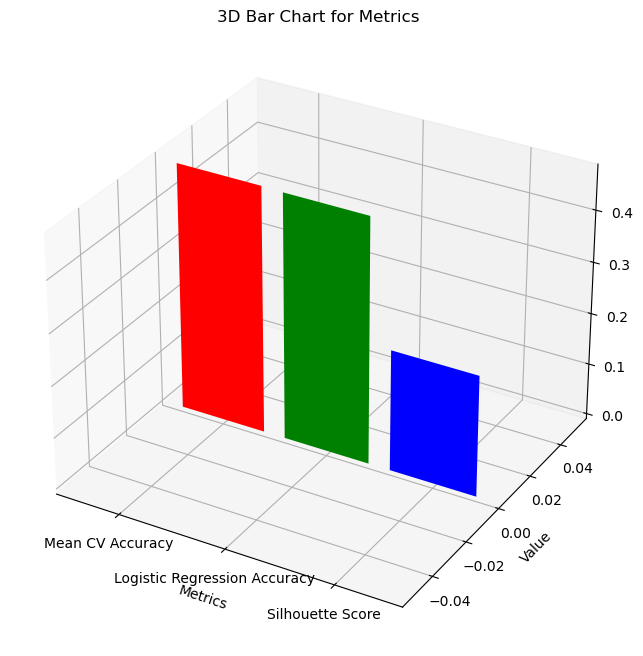

In [37]:
from mpl_toolkits.mplot3d import Axes3D

# Create a 3D figure
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Define the metrics and their corresponding values
metrics = ['Mean CV Accuracy', 'Logistic Regression Accuracy', 'Silhouette Score']
values = [mean_accuracy, accuracy, silhouette_avg]

# Create a bar chart in 3D
ax.bar(metrics, values, zdir='y', color=['r', 'g', 'b'])

# Set labels and title
ax.set_xlabel('Metrics')
ax.set_ylabel('Value')
ax.set_title('3D Bar Chart for Metrics')

plt.show()